In [2]:
import pandas as pd
import numpy as np
%matplotlib inline

from sklearn.impute import SimpleImputer
import sys
import os
import warnings

import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from statsmodels.graphics.tsaplots import plot_acf

import sklearn
import skforecast
from sklearn.preprocessing import StandardScaler, OrdinalEncoder, MinMaxScaler
from sklearn.feature_selection import RFECV
from sklearn.ensemble import  HistGradientBoostingRegressor, RandomForestRegressor
from skforecast.ForecasterAutoregMultiSeries import ForecasterAutoregMultiSeries
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import bayesian_search_forecaster
from skforecast.model_selection_multiseries import backtesting_forecaster_multiseries
from skforecast.model_selection_multiseries import bayesian_search_forecaster_multiseries
from skforecast.model_selection_multiseries import select_features_multiseries
from skforecast.plot import set_dark_theme
from skforecast.preprocessing import series_long_to_dict
from skforecast.preprocessing import exog_long_to_dict
from datetime import timedelta
from lightgbm import LGBMRegressor
import utils as u
from sklearn.metrics import classification_report
import joblib

warnings.filterwarnings('once')

color = '\033[1m\033[38;5;208m'
print(f"{color}Version skforecast: {skforecast.__version__}")
print(f"{color}Version scikit-learn: {sklearn.__version__}")
print(f"{color}Version pandas: {pd.__version__}")
print(f"{color}Version numpy: {np.__version__}")

c:\Users\andre\miniconda3\envs\crypto-model\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Version skforecast: 0.13.0
Version scikit-learn: 1.5.2
Version pandas: 2.2.3
Version numpy: 1.26.4


## Loading meme data

In [3]:
gaming = pd.read_csv('../data/processed/gaming.csv')
ai = pd.read_csv('../data/processed/ai.csv')
meme = pd.read_csv('../data/processed/meme.csv')
rwa = pd.read_csv('../data/processed/rwa.csv')

gaming.shape, ai.shape, meme.shape, rwa.shape

((128218, 12), (115321, 12), (33840, 12), (53289, 12))

## Preprocessing data

In [4]:
days_to_predict = 7

In [5]:
class category_data:
    def __init__(self, train_data, series_dict, exog_dict, future_exog_dict, series_scaler, exog_scaler):
        self.train_data = train_data
        self.series_dict = series_dict
        self.exog_dict = exog_dict
        self.future_exog_dict = future_exog_dict
        self.series_scaler = series_scaler
        self.exog_scaler = exog_scaler
        self.forecaster = None
        self.predictions = None
        self.og_train = None
        self.og_pred = None
        self.error_df = None
        self.close_df = None

In [6]:
def generate_data_object(data: pd.DataFrame, days: int):
    train_data, series_dict, exog_dict, future_exog_dict, series_scaler, exog_scaler = u.preprocess_future(data, days_to_predict=days)
    data_obj = category_data(train_data, series_dict, exog_dict, future_exog_dict, series_scaler, exog_scaler)
    return data_obj

In [7]:
gaming_obj = generate_data_object(gaming, days_to_predict)
ai_obj = generate_data_object(ai, days_to_predict)
meme_obj = generate_data_object(meme, days_to_predict)
rwa_obj = generate_data_object(rwa, days_to_predict)

In [8]:
print(gaming_obj.train_data['id'].nunique())
print(ai_obj.train_data['id'].nunique())
print(meme_obj.train_data['id'].nunique())
print(rwa_obj.train_data['id'].nunique())

92
73
32
38


In [9]:
# gaming_obj.forecaster = u.train_best_forecaster(gaming_obj.series_dict, gaming_obj.exog_dict, gaming_obj.future_exog_dict, gaming_obj.test_data, future_days=days_to_predict)
# ai_obj.forecaster = u.train_best_forecaster(ai_obj.series_dict, ai_obj.exog_dict, ai_obj.future_exog_dict, ai_obj.test_data, future_days=days_to_predict)
# meme_obj.forecaster = u.train_best_forecaster(meme_obj.series_dict, meme_obj.exog_dict, meme_obj.future_exog_dict, meme_obj.test_data, future_days=days_to_predict)
# rwa_obj.forecaster = u.train_best_forecaster(rwa_obj.series_dict, rwa_obj.exog_dict, rwa_obj.future_exog_dict, rwa_obj.test_data, future_days=days_to_predict)

In [10]:
gaming_obj.forecaster = u.train_forecaster(gaming_obj.series_dict, gaming_obj.exog_dict)
ai_obj.forecaster = u.train_forecaster(ai_obj.series_dict, ai_obj.exog_dict)
meme_obj.forecaster = u.train_forecaster(meme_obj.series_dict, meme_obj.exog_dict)
rwa_obj.forecaster = u.train_forecaster(rwa_obj.series_dict, rwa_obj.exog_dict)

{'loss_function': 'RMSE', 'silent': True, 'max_depth': 5, 'random_state': 123}
{'loss_function': 'RMSE', 'silent': True, 'max_depth': 5, 'random_state': 123}
{'loss_function': 'RMSE', 'silent': True, 'max_depth': 5, 'random_state': 123}
{'loss_function': 'RMSE', 'silent': True, 'max_depth': 5, 'random_state': 123}


In [11]:
gaming_obj.predictions = u.predict_X_days(days_to_predict=days_to_predict, forecaster=gaming_obj.forecaster, future_exog_dict=gaming_obj.future_exog_dict)
ai_obj.predictions = u.predict_X_days(days_to_predict=days_to_predict, forecaster=ai_obj.forecaster, future_exog_dict=ai_obj.future_exog_dict)
meme_obj.predictions = u.predict_X_days(days_to_predict=days_to_predict, forecaster=meme_obj.forecaster, future_exog_dict=meme_obj.future_exog_dict)
rwa_obj.predictions = u.predict_X_days(days_to_predict=days_to_predict, forecaster=rwa_obj.forecaster, future_exog_dict=rwa_obj.future_exog_dict)

In [12]:
gaming_obj.og_train, gaming_obj.og_pred = u.inverse_scaling_future(train_df=gaming_obj.train_data, pred_df=gaming_obj.predictions, scalers=gaming_obj.series_scaler)
ai_obj.og_train, ai_obj.og_pred = u.inverse_scaling_future(train_df=ai_obj.train_data, pred_df=ai_obj.predictions, scalers=ai_obj.series_scaler)
meme_obj.og_train, meme_obj.og_pred = u.inverse_scaling_future(train_df=meme_obj.train_data, pred_df=meme_obj.predictions, scalers=meme_obj.series_scaler)
rwa_obj.og_train, rwa_obj.og_pred = u.inverse_scaling_future(train_df=rwa_obj.train_data, pred_df=rwa_obj.predictions, scalers=rwa_obj.series_scaler)

In [13]:
gaming_obj.og_train

,timestamp,open,high,low,close,volume,name,symbol,id,category,marketcap,image,days_until_halving
0,2022-06-18,0.063849,0.064373,0.063849,0.064100,3.097913e+03,Dark Frontiers,DARK,049abaff-71e0-4b1a-bcee-942cb1630222,gaming,5597833,https://s2.coinmarketcap.com/static/img/coins/...,0.002365
1,2022-06-19,0.062489,0.062665,0.062130,0.062665,2.388143e+03,Dark Frontiers,DARK,049abaff-71e0-4b1a-bcee-942cb1630222,gaming,5597833,https://s2.coinmarketcap.com/static/img/coins/...,0.000064
2,2022-06-20,0.062719,0.062724,0.062719,0.062724,8.063360e+02,Dark Frontiers,DARK,049abaff-71e0-4b1a-bcee-942cb1630222,gaming,5597833,https://s2.coinmarketcap.com/static/img/coins/...,-0.002236
3,2022-06-21,0.067348,0.067348,0.065770,0.065770,9.486514e+03,Dark Frontiers,DARK,049abaff-71e0-4b1a-bcee-942cb1630222,gaming,5597833,https://s2.coinmarketcap.com/static/img/coins/...,-0.004537
4,2022-06-22,0.068548,0.068548,0.068520,0.068520,6.993662e+01,Dark Frontiers,DARK,049abaff-71e0-4b1a-bcee-942cb1630222,gaming,5597833,https://s2.coinmarketcap.com/static/img/coins/...,-0.006837
...,...,...,...,...,...,...,...,...,...,...,...,...,...
102362,2024-11-05,0.024158,0.024934,0.021531,0.022208,6.348249e+05,Guild of Guardians,GOG,fc58d32a-af0e-43db-be43-2ad2f257151c,gaming,30030615,https://s2.coinmarketcap.com/static/img/coins/...,1.306732
102363,2024-11-06,0.022070,0.029916,0.021657,0.026510,8.072269e+05,Guild of Guardians,GOG,fc58d32a-af0e-43db-be43-2ad2f257151c,gaming,30030615,https://s2.coinmarketcap.com/static/img/coins/...,1.304432
102364,2024-11-07,0.026471,0.027021,0.024245,0.025317,3.541630e+05,Guild of Guardians,GOG,fc58d32a-af0e-43db-be43-2ad2f257151c,gaming,30030615,https://s2.coinmarketcap.com/static/img/coins/...,1.302132
102365,2024-11-08,0.025396,0.041610,0.025351,0.032240,2.070515e+06,Guild of Guardians,GOG,fc58d32a-af0e-43db-be43-2ad2f257151c,gaming,30030615,https://s2.coinmarketcap.com/static/img/coins/...,1.299831


In [14]:
gaming_obj.og_pred

,049abaff-71e0-4b1a-bcee-942cb1630222,06963e10-2042-41d3-9583-acb4135460dc,0844705f-10ed-42ca-b483-914b7d59e351,0889f611-0e32-4e5e-be44-d87dcf8bf9cf,10e910bd-6f50-4085-bd78-fbbcde408d28,126938ad-16e3-423a-8803-69d011694a48,199c287f-3646-49cf-afd3-e17758f66cf0,1ae14641-7365-4be1-9bb9-c86ab07715b3,1d3bfcac-acb6-46ed-99b2-94122b8de833,2150225f-b2f2-4b59-bc68-001aa8ae4666,...,c945198e-88f1-416d-abc5-e4cb465be078,d08e692f-7064-4406-9789-98e688699479,dd32a002-d816-4592-ba34-d43aab08255f,def04c24-d3a3-4b80-8eb1-98f9a91c80c9,e39a2a75-3b24-4235-8abb-cda6d2c91b55,e6ca0755-75f7-41c1-b354-4a0de9867c0b,ee667b5c-2eed-417a-b472-cf7a5af44a8f,f14d3862-f857-4705-8fda-40da9c7aa198,f5bf148f-d833-408a-83eb-50e12d2139ee,fc58d32a-af0e-43db-be43-2ad2f257151c
2024-11-10,0.019536,0.003126,0.325285,0.030082,0.059813,0.159630,0.014330,1.348986,0.271747,0.045559,...,0.012700,0.156035,0.000548,0.002517,0.001812,0.507816,0.823022,0.005474,0.000611,0.033291
2024-11-11,0.019494,0.003235,0.330370,0.029570,0.058628,0.157108,0.014081,1.339547,0.265922,0.044961,...,0.011302,0.155733,0.000690,0.003851,0.001291,0.513347,0.810128,0.005823,0.000610,0.033590
2024-11-12,0.019243,0.003255,0.331134,0.030252,0.058221,0.158084,0.014128,1.341768,0.274153,0.046166,...,0.010704,0.154242,0.000787,0.004479,0.001229,0.522026,0.829097,0.006008,0.000602,0.034222
2024-11-13,0.019593,0.003613,0.337966,0.030213,0.060909,0.166164,0.014833,1.360284,0.271291,0.047622,...,0.019419,0.157242,0.000915,0.006091,0.002772,0.544387,0.854254,0.006894,0.000707,0.038029
2024-11-14,0.019557,0.003605,0.343906,0.030472,0.061168,0.166059,0.014639,1.366871,0.273171,0.054074,...,0.036168,0.157358,0.000921,0.007683,0.004710,0.540257,0.837438,0.006946,0.000683,0.037477
2024-11-15,0.019585,0.003910,0.350022,0.030645,0.061356,0.167510,0.015909,1.358733,0.271074,0.055724,...,0.039573,0.156871,0.000937,0.008402,0.005303,0.527026,0.896173,0.006918,0.000671,0.040075
2024-11-16,0.019587,0.003982,0.354270,0.030774,0.061435,0.172248,0.015242,1.364739,0.273760,0.055996,...,0.046832,0.157131,0.000962,0.008933,0.005076,0.560762,0.847449,0.007311,0.000826,0.039500


In [15]:
def media_movil_simple(valores):
    n = len(valores)
    if n == 0:
        return 0
    return sum(valores) / n

def media_movil_ponderada(valores):
    n = len(valores)
    pesos = range(1, n + 1)
    return sum(v * p for v, p in zip(valores, pesos)) / sum(pesos)

def obtener_valores_anteriores(df, columna, indice_negativo, cantidad=14):
    inicio = max(indice_negativo - cantidad, 0)
    return df[columna].iloc[inicio:indice_negativo + 1].tolist()

def completar_valores_con_train(df_pred, df_train, id_moneda, fecha_negativa, cantidad_total=15):
    # Filtrar los datos de entrenamiento por el ID de la moneda
    datos_moneda = df_train[df_train['id'] == id_moneda]
    valores_close = []

    # Obtener el valor de close en la fecha negativa
    valor_fecha_negativa = datos_moneda[datos_moneda['timestamp'] == fecha_negativa]['close']

    if not valor_fecha_negativa.empty:
        valores_close.append(valor_fecha_negativa.values[0])

    # Obtener valores de close hasta completar 15 valores
    for i in range(1, cantidad_total):
        fecha_anterior = pd.to_datetime(fecha_negativa) - pd.Timedelta(days=i)
        valor_anterior = datos_moneda[datos_moneda['timestamp'] == fecha_anterior.strftime('%Y-%m-%d')]
        
        if not valor_anterior.empty:
            valores_close.append(valor_anterior['close'].values[0])
        else:
            break

    return valores_close

def reemplazar_valores_negativos_ponderada(df_pred, df_train):
    for columna in df_pred.columns:
        for i in range(len(df_pred)):
            valor_actual = df_pred[columna].iloc[i]

            if valor_actual < 0:
                # Obtener 14 valores anteriores
                valores_anteriores = obtener_valores_anteriores(df_pred, columna, i)

                # Si hay suficientes valores, calcular la media
                if len(valores_anteriores) == 15:
                    media_ponderada = media_movil_ponderada(valores_anteriores)
                else:
                    # Completar con datos de gaming_obj.og_train
                    fecha_negativa = df_pred.index[i]
                    id_moneda = columna
                    valores_necesarios = completar_valores_con_train(df_pred, df_train, id_moneda, fecha_negativa)
                    # Concatenar valores anteriores con los obtenidos de og_train
                    valores_totales = valores_anteriores + valores_necesarios
                    media_ponderada = media_movil_ponderada(valores_totales)

                # Reemplazar el valor negativo con la media móvil ponderada
                df_pred[columna].iloc[i] = max(media_ponderada, 0)

    return df_pred

In [16]:
gaming_obj.og_pred = reemplazar_valores_negativos_ponderada(gaming_obj.og_pred, gaming_obj.og_train)
ai_obj.og_pred = reemplazar_valores_negativos_ponderada(ai_obj.og_pred, ai_obj.og_train)
meme_obj.og_pred = reemplazar_valores_negativos_ponderada(meme_obj.og_pred, meme_obj.og_train)
rwa_obj.og_pred = reemplazar_valores_negativos_ponderada(rwa_obj.og_pred, rwa_obj.og_train)

C:\Users\andre\AppData\Local\Temp\ipykernel_8592\3999421364.py:61: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_pred[columna].iloc[i] = max(media_ponderada, 0)
C:\Users\andre\AppData\Local\Temp\ipykernel_8592\3999421364.py:61: FutureWarn

In [17]:
gaming_test = pd.read_csv("../data/processed/test/gaming.csv")
ai_test = pd.read_csv("../data/processed/test/ai.csv")
meme_test = pd.read_csv("../data/processed/test/meme.csv")
rwa_test = pd.read_csv("../data/processed/test/rwa.csv")

gaming_test.shape, ai_test.shape, meme_test.shape, rwa_test.shape

((631, 10), (506, 10), (220, 10), (266, 10))

In [18]:
gaming_test['timestamp'] = pd.to_datetime(gaming_test['timestamp'], unit='s')
ai_test['timestamp'] = pd.to_datetime(ai_test['timestamp'], unit='s')
meme_test['timestamp'] = pd.to_datetime(meme_test['timestamp'], unit='s')
rwa_test['timestamp'] = pd.to_datetime(rwa_test['timestamp'], unit='s')

In [19]:
gaming_obj.close_df = u.get_last_close_info(gaming_obj.og_train, gaming_test, gaming_obj.og_pred)
ai_obj.close_df = u.get_last_close_info(ai_obj.og_train, ai_test, ai_obj.og_pred)
meme_obj.close_df = u.get_last_close_info(meme_obj.og_train, meme_test, meme_obj.og_pred)
rwa_obj.close_df = u.get_last_close_info(rwa_obj.og_train, rwa_test, rwa_obj.og_pred)

In [20]:
print("Gaming")
print(classification_report(gaming_obj.close_df['real_went_up'], gaming_obj.close_df['pred_went_up']))
print("AI")
print(classification_report(ai_obj.close_df['real_went_up'], ai_obj.close_df['pred_went_up']))
print("Meme")
print(classification_report(meme_obj.close_df['real_went_up'], meme_obj.close_df['pred_went_up']))
print("RWA")
print(classification_report(rwa_obj.close_df['real_went_up'], rwa_obj.close_df['pred_went_up']))

Gaming
              precision    recall  f1-score   support

         0.0       0.20      0.08      0.11        38
         1.0       0.55      0.78      0.64        54

    accuracy                           0.49        92
   macro avg       0.37      0.43      0.38        92
weighted avg       0.40      0.49      0.42        92

AI
              precision    recall  f1-score   support

         0.0       0.67      0.07      0.12        29
         1.0       0.61      0.98      0.75        44

    accuracy                           0.62        73
   macro avg       0.64      0.52      0.44        73
weighted avg       0.64      0.62      0.50        73

Meme
              precision    recall  f1-score   support

         0.0       0.17      0.50      0.25         4
         1.0       0.90      0.64      0.75        28

    accuracy                           0.62        32
   macro avg       0.53      0.57      0.50        32
weighted avg       0.81      0.62      0.69        32

RWA


In [21]:
gaming_obj.error_df = u.compute_errors(train_data=gaming_obj.og_train, predictions_x_days=gaming_obj.og_pred, test_data=gaming_test)
ai_obj.error_df = u.compute_errors(train_data=ai_obj.og_train, predictions_x_days=ai_obj.og_pred, test_data=ai_test)
meme_obj.error_df = u.compute_errors(train_data=meme_obj.og_train, predictions_x_days=meme_obj.og_pred, test_data=meme_test)
rwa_obj.error_df = u.compute_errors(train_data=rwa_obj.og_train, predictions_x_days=rwa_obj.og_pred, test_data=rwa_test)

In [22]:
# in rwa_obj.og_train get the rows with symbol == 'TRL'
ai_obj.og_train[ai_obj.og_train['symbol'] == 'TRL']

,timestamp,open,high,low,close,volume,name,symbol,id,category,marketcap,image,days_until_halving
44826,2021-09-28,0.887860,1.009837,0.524224,0.705534,928140.580450,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,0.571088
44827,2021-09-29,0.697037,0.720630,0.366204,0.379281,195030.361535,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,0.568777
44828,2021-09-30,0.382600,0.467924,0.378283,0.412182,62911.755403,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,0.566466
44829,2021-10-01,0.391361,0.420221,0.358315,0.412714,31577.194738,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,0.564155
44830,2021-10-02,0.416383,0.480759,0.416327,0.480759,9876.336984,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,0.561844
...,...,...,...,...,...,...,...,...,...,...,...,...,...
45832,2024-10-18,0.001951,0.001951,0.001950,0.001950,21.454190,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,1.315221
45833,2024-10-29,0.002793,0.002793,0.002793,0.002793,26.499527,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,1.289800
45834,2024-10-30,0.001972,0.001972,0.001971,0.001971,96.397273,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,1.287489
45835,2024-10-31,0.001993,0.001994,0.001961,0.001962,149.693991,Triall,TRL,69469e96-c2a4-444e-9817-8972476e3a09,ai,112833,https://s2.coinmarketcap.com/static/img/coins/...,1.285178


In [23]:
ai_obj.og_pred['69469e96-c2a4-444e-9817-8972476e3a09']

2024-11-10    0.014802
2024-11-11    0.017934
2024-11-12    0.015508
2024-11-13    0.015242
2024-11-14    0.013937
2024-11-15    0.016443
2024-11-16    0.017536
Freq: D, Name: 69469e96-c2a4-444e-9817-8972476e3a09, dtype: float64

In [24]:
meme_obj.og_pred

,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,05bf91a3-52e5-40ef-b09d-0c471617116e,0d8b00d2-9e0a-4489-891b-6e663a6fcd10,1a5aa1bf-0512-4a7d-ac19-ddaccfbee99f,21bca36c-d10c-4df1-87aa-25888c272328,24f283e8-459a-451a-aa23-e7d87058bc8e,30321bcc-7749-4c54-824d-a308a68ae4f9,474ab169-7082-4128-90ef-6004690230c4,4b58504f-c66e-41ab-88f4-fc923ca41910,4f17ed41-ad49-4693-9e09-066fc70ac686,...,9fb6e340-7969-4047-86ae-d60cb11a70ad,beded6db-7cfa-4ebc-8a27-4b27b4401d6b,c16cce0c-f968-4df0-9165-d790336bef6f,c2b6aa74-ad3c-4b6d-8ddb-d649fadf27ae,dbd393f1-f374-439d-a705-636261b88096,dce01826-60a0-4bf0-b917-0a54840327a8,de219c84-a43e-4d70-b29d-40735250282c,e365ad15-0867-4b03-864e-1ab59f21ef00,e399a238-6810-4ad4-93d9-24f110e85cdb,e7f6fb5c-b7e6-45b4-b9ed-3f3c761f280e
2024-11-10,0.000011,5.998053e-12,0.008973,0.000580,0.002878,0.000006,0.002603,0.009778,3.351506e-10,1.598129e-07,...,0.000144,0.107111,0.000008,0.000024,0.011168,0.008115,0.000002,1.118085e-08,1.396016e-07,0.000023
2024-11-11,0.000011,5.500766e-12,0.008917,0.000617,0.002831,0.000006,0.002960,0.010772,3.384610e-10,1.626332e-07,...,0.000149,0.111129,0.000008,0.000025,0.011205,0.008201,0.000002,1.134232e-08,1.460546e-07,0.000023
2024-11-12,0.000011,4.791904e-12,0.008544,0.000639,0.002752,0.000006,0.003017,0.010726,3.287548e-10,1.612509e-07,...,0.000152,0.115507,0.000009,0.000027,0.011165,0.008172,0.000002,1.123884e-08,1.459538e-07,0.000023
2024-11-13,0.000011,0.000000e+00,0.008468,0.000660,0.002810,0.000006,0.002907,0.011052,3.119440e-10,1.632640e-07,...,0.000156,0.117087,0.000009,0.000028,0.011183,0.008178,0.000002,1.123670e-08,1.325752e-07,0.000023
2024-11-14,0.000011,0.000000e+00,0.008175,0.000654,0.002820,0.000006,0.002968,0.010910,2.964772e-10,1.664140e-07,...,0.000157,0.117952,0.000009,0.000029,0.011139,0.008056,0.000002,1.141062e-08,1.783115e-07,0.000023
2024-11-15,0.000011,0.000000e+00,0.008285,0.000672,0.002863,0.000006,0.003253,0.011096,3.145202e-10,1.705113e-07,...,0.000163,0.118817,0.000010,0.000031,0.011250,0.008151,0.000002,1.136084e-08,2.072653e-07,0.000023
2024-11-16,0.000011,0.000000e+00,0.008340,0.000677,0.002840,0.000006,0.003520,0.011175,3.168511e-10,1.693897e-07,...,0.000164,0.119065,0.000012,0.000030,0.011193,0.008168,0.000002,1.133866e-08,2.030156e-07,0.000023


In [25]:
meme_obj.error_df

,Token ID,MSE,MAE,MAPE,MAPE (%)
0,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,6.796741e-11,7.061648e-06,3.555976e+01,35.56%
1,05bf91a3-52e5-40ef-b09d-0c471617116e,6.100249e-22,2.366683e-11,9.136830e+01,91.37%
2,0d8b00d2-9e0a-4489-891b-6e663a6fcd10,4.275836e-07,6.002379e-04,6.560720e+00,6.56%
3,1a5aa1bf-0512-4a7d-ac19-ddaccfbee99f,9.597440e-09,7.536488e-05,1.025849e+01,10.26%
4,21bca36c-d10c-4df1-87aa-25888c272328,1.143167e-02,7.024517e-02,5.376991e+01,53.77%
5,24f283e8-459a-451a-aa23-e7d87058bc8e,4.871794e-13,6.516975e-07,1.091090e+01,10.91%
6,30321bcc-7749-4c54-824d-a308a68ae4f9,2.048645e-07,4.129874e-04,1.229766e+01,12.30%
7,474ab169-7082-4128-90ef-6004690230c4,2.398191e-06,1.264581e-03,1.059495e+01,10.59%
8,4b58504f-c66e-41ab-88f4-fc923ca41910,3.108894e-20,1.719778e-10,3.457204e+01,34.57%
9,4f17ed41-ad49-4693-9e09-066fc70ac686,5.059272e-15,6.589560e-08,2.775544e+01,27.76%


In [26]:
gaming_obj.error_df

,Token ID,MSE,MAE,MAPE,MAPE (%)
0,049abaff-71e0-4b1a-bcee-942cb1630222,1.617774e-06,0.000926,4.694319,4.69%
1,06963e10-2042-41d3-9583-acb4135460dc,4.354204e-07,0.000505,11.116464,11.12%
2,0844705f-10ed-42ca-b483-914b7d59e351,1.239306e-03,0.026330,6.910311,6.91%
3,0889f611-0e32-4e5e-be44-d87dcf8bf9cf,4.498262e-06,0.001920,6.587053,6.59%
4,10e910bd-6f50-4085-bd78-fbbcde408d28,2.079633e-05,0.003496,5.347659,5.35%
...,...,...,...,...,...
87,e6ca0755-75f7-41c1-b354-4a0de9867c0b,1.088646e-03,0.028046,5.455110,5.46%
88,ee667b5c-2eed-417a-b472-cf7a5af44a8f,5.066392e-03,0.063641,7.981073,7.98%
89,f14d3862-f857-4705-8fda-40da9c7aa198,4.124925e-06,0.001914,42.010212,42.01%
90,f5bf148f-d833-408a-83eb-50e12d2139ee,5.509737e-08,0.000211,47.500352,47.50%


In [ ]:
ai_obj.error_dfS

,Token ID,MSE,MAE,MAPE,MAPE (%)
0,040f0133-1654-4e4e-85ac-417155ca814f,2.679101e+03,40.604458,7.137908,7.14%
1,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,4.268398e-04,0.018483,41.573646,41.57%
2,04ad4e18-9643-458b-b805-e2d767a161e4,3.260721e-06,0.001586,25.087849,25.09%
3,050cd820-2c82-4222-892c-e6f2859625c7,6.115277e-09,0.000065,14.042814,14.04%
4,0b3d4b05-d9eb-490e-a50f-066fbfed06ac,2.056905e-04,0.011643,6.052847,6.05%
...,...,...,...,...,...
68,f59f39ff-5230-42bb-acce-7767dc84cd83,4.027870e-06,0.001398,15.628990,15.63%
69,fcb726c7-364f-4252-8ee8-70b0bbbd8791,1.932482e-04,0.011845,6.180655,6.18%
70,fefa947d-7719-4915-b24f-29a25ab34e80,3.009059e+00,1.394523,55.051639,55.05%
71,ff9c05cd-d3f6-4495-b8d6-7e6530a6dcab,3.445589e-07,0.000494,21.592144,21.59%


In [28]:
rwa_obj.error_df

,Token ID,MSE,MAE,MAPE,MAPE (%)
0,0d0d9689-bf75-41ee-9555-aa2f2ca0186b,8.623584e-04,0.025958,7.026042,7.03%
1,0f2d0434-2ff5-4166-8d59-5cb1e5b102e1,2.266416e-06,0.001311,8.760145,8.76%
2,13af58e4-0242-4aa0-8d09-e0aaa262f761,9.128546e-06,0.002684,63.107374,63.11%
3,19850b5a-a264-4954-a312-67d15c77f347,2.151386e-03,0.038200,2987.722080,2987.72%
4,1bc28038-aa5b-4e3d-9ad9-eaf8cbfed677,4.389144e-05,0.006401,11.376607,11.38%
5,1c1cd416-b027-4d73-9d4d-0a9edc63524d,9.131432e-05,0.008181,4.204161,4.20%
6,20a20296-c751-4011-88fa-fc2b8b0a8564,7.861139e-08,0.000248,5.857106,5.86%
7,2db6b38a-681a-4514-9d67-691e319597ee,1.224345e+01,3.168503,9.299217,9.30%
8,317d6ffb-c0b3-43c1-a88a-e19ab22d6171,9.857050e-04,0.025798,12.575689,12.58%
9,39a5cc70-09c6-4e20-899e-131507186776,2.191350e-04,0.013440,15.511339,15.51%


In [ ]:
u.plot_predictions_only(train_data=gaming_obj.og_train, predictions_x_days=gaming_obj.og_pred, last_data_points=120)

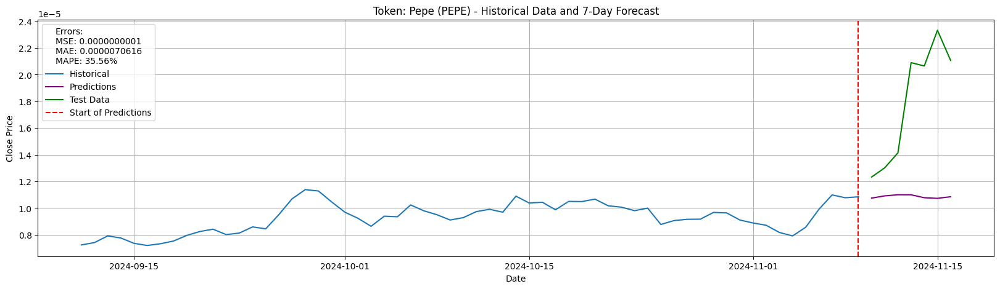

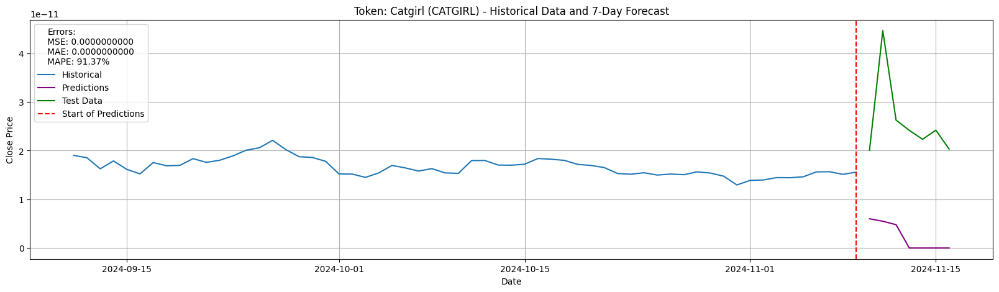

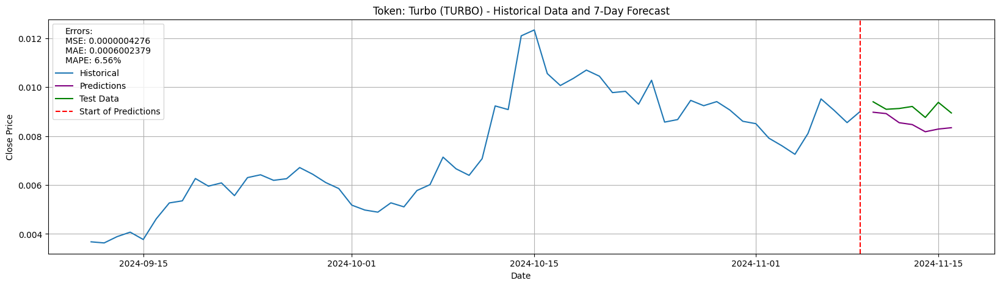

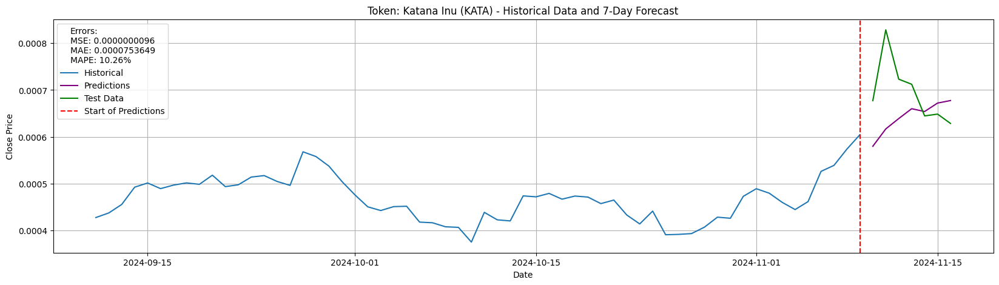

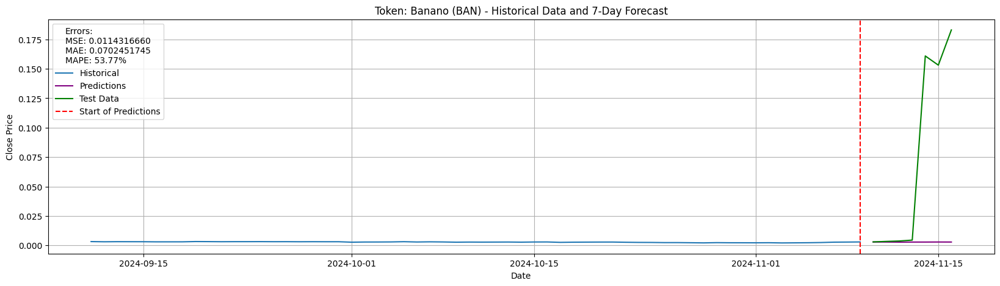

...

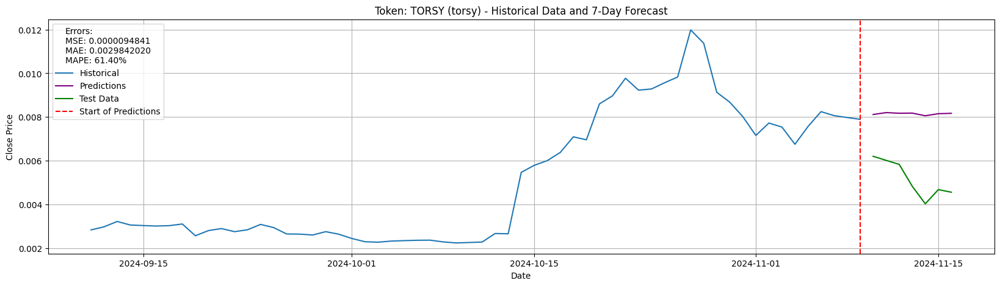

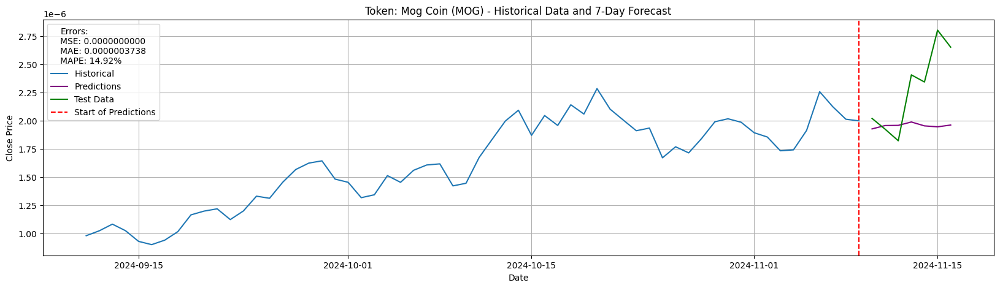

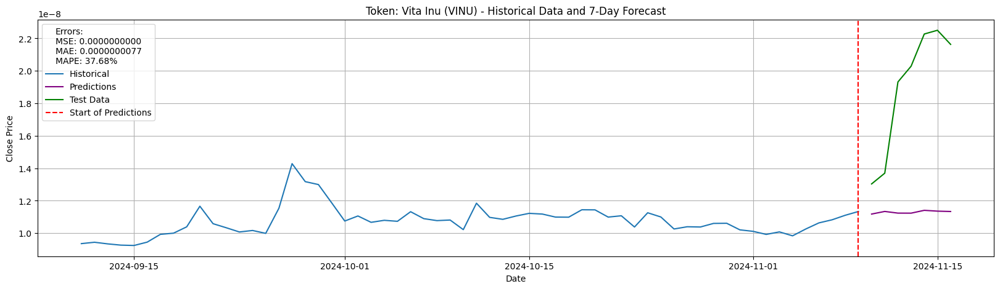

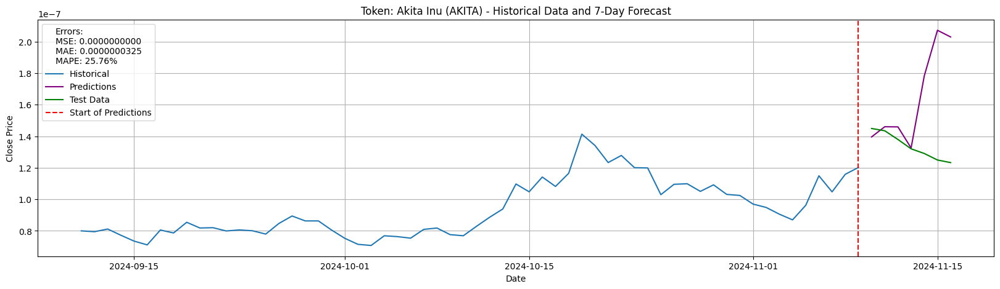

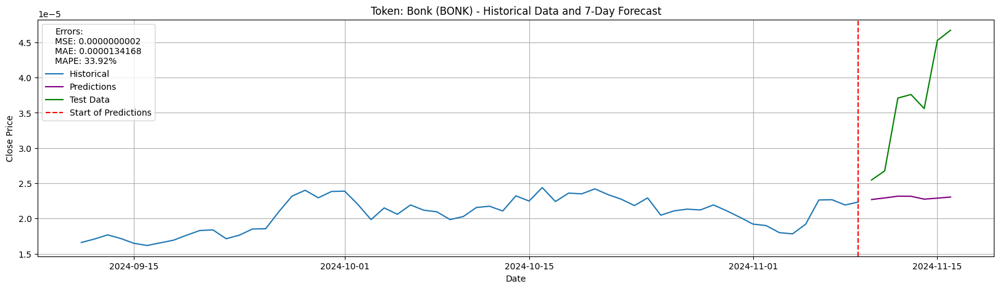

In [33]:
u.plot_predictions(train_data=meme_obj.og_train, predictions_x_days=meme_obj.og_pred, test_data=meme_test, last_data_points=60)

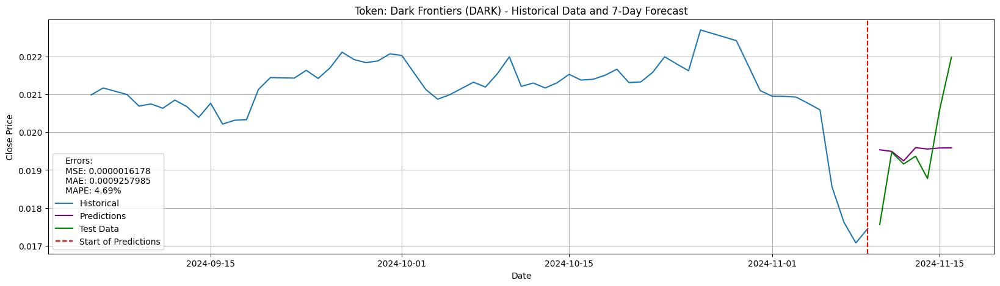

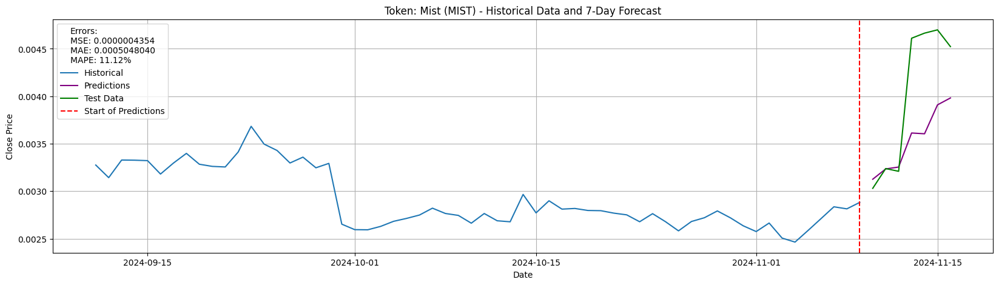

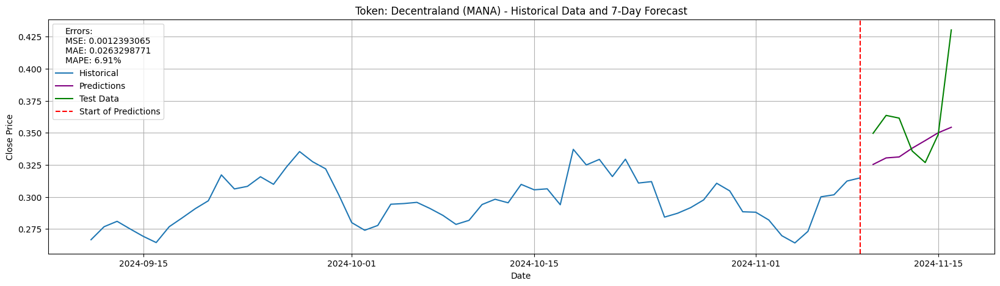

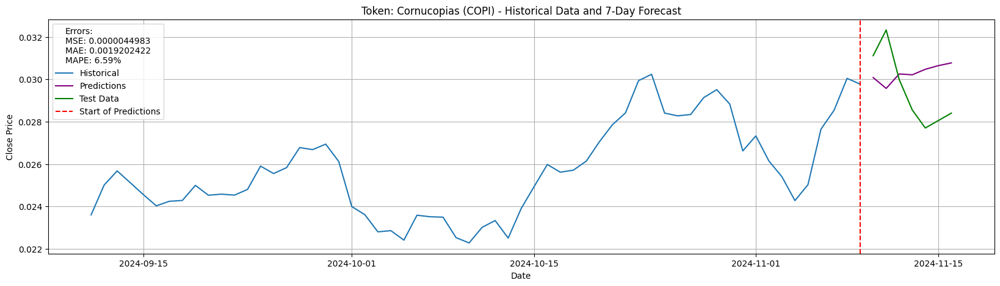

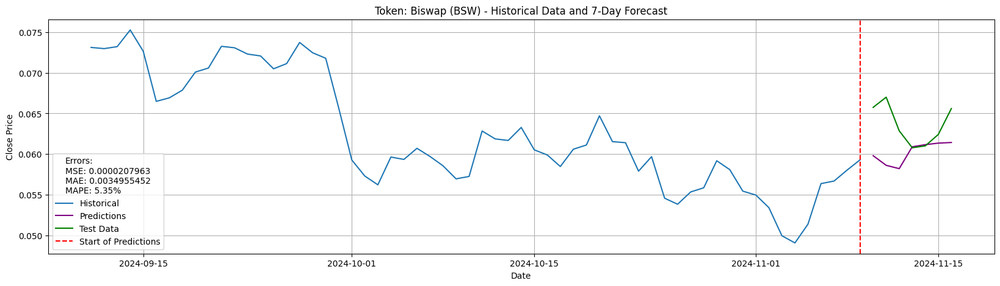

...

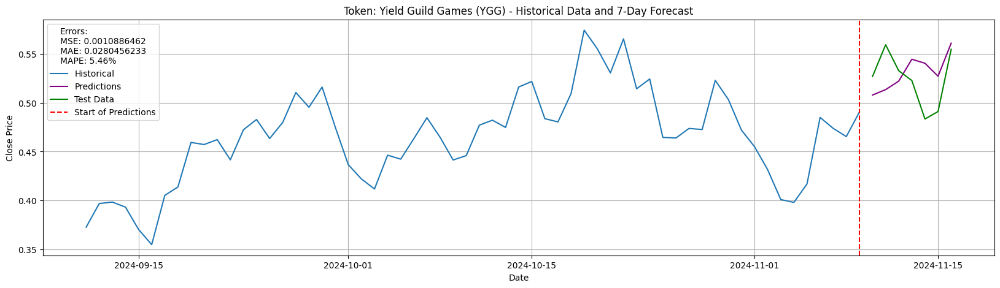

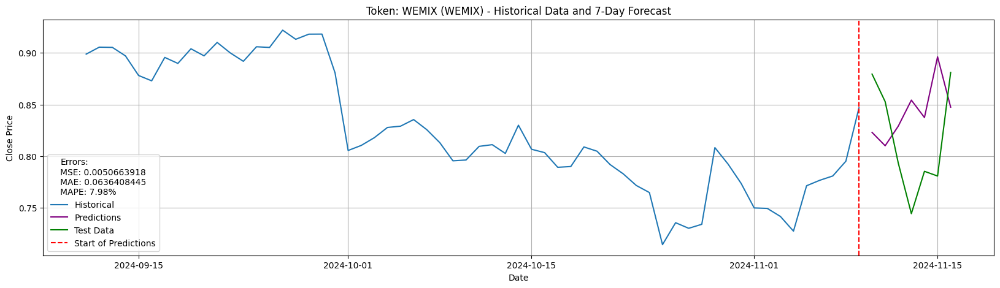

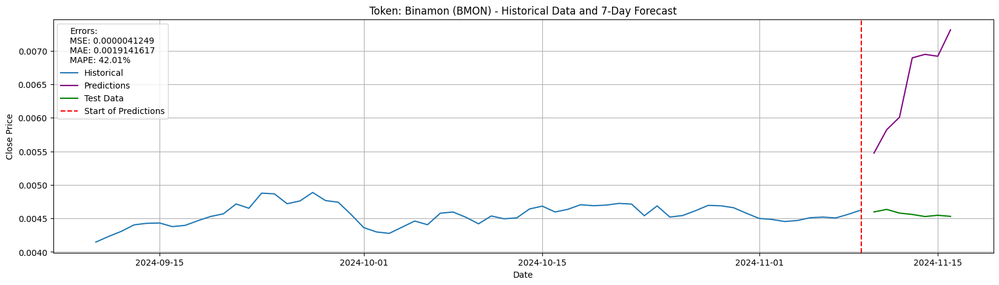

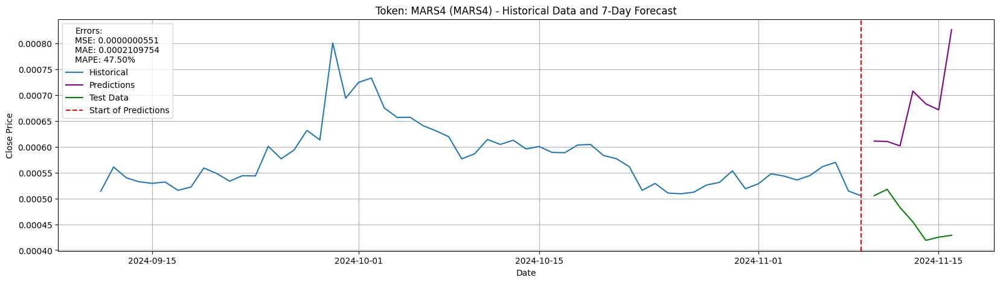

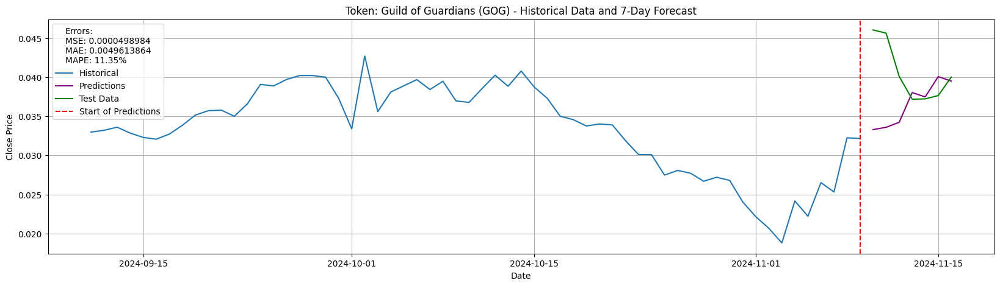

In [24]:
u.plot_predictions(train_data=gaming_obj.og_train, predictions_x_days=gaming_obj.og_pred, test_data=gaming_test, last_data_points=60)

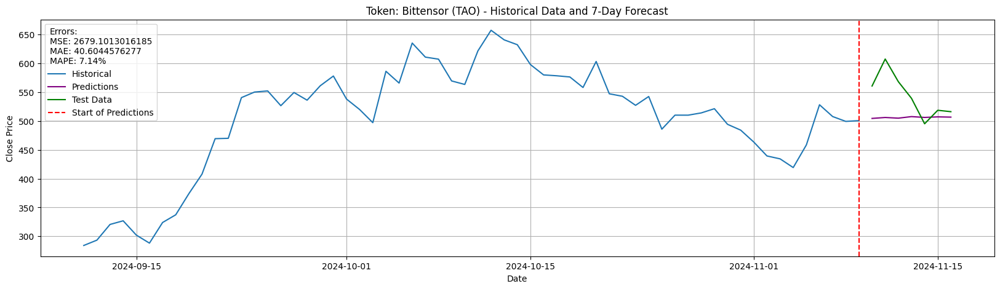

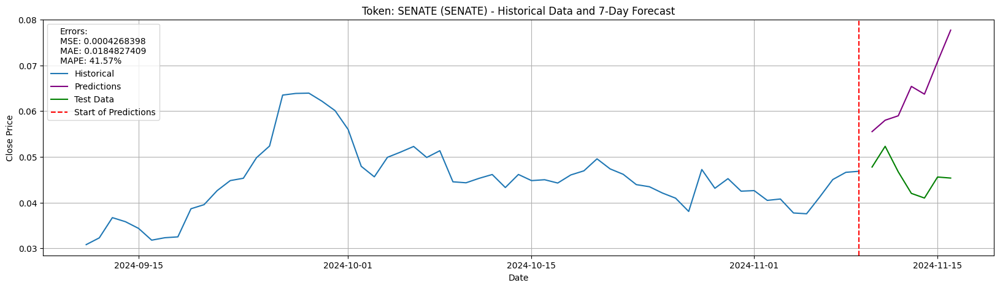

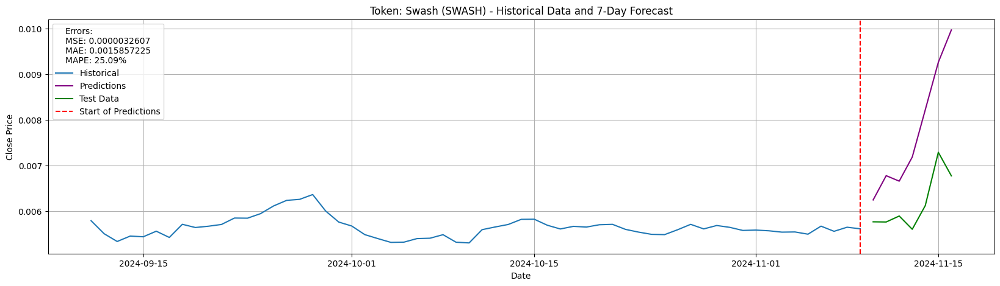

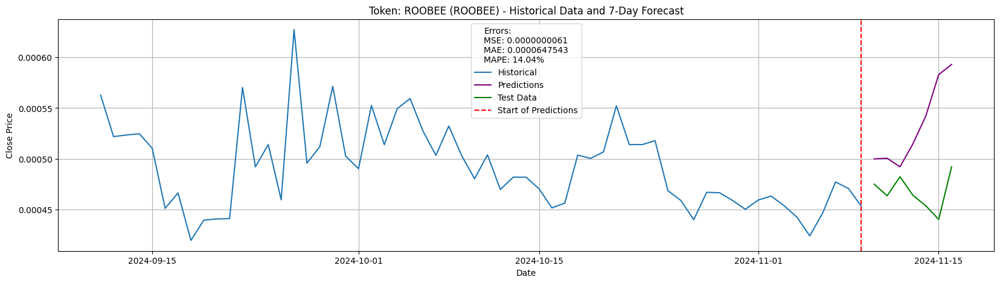

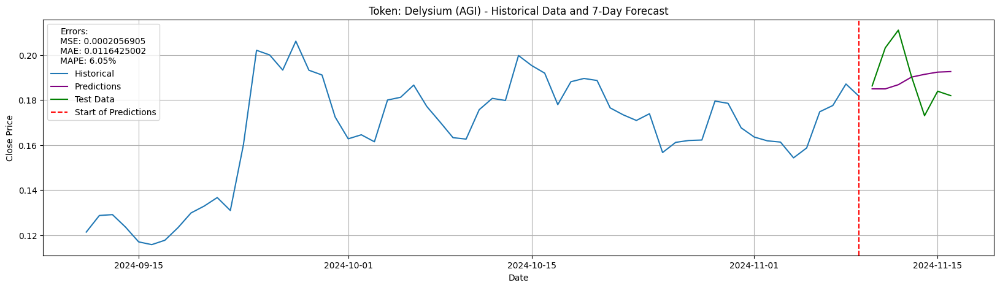

...

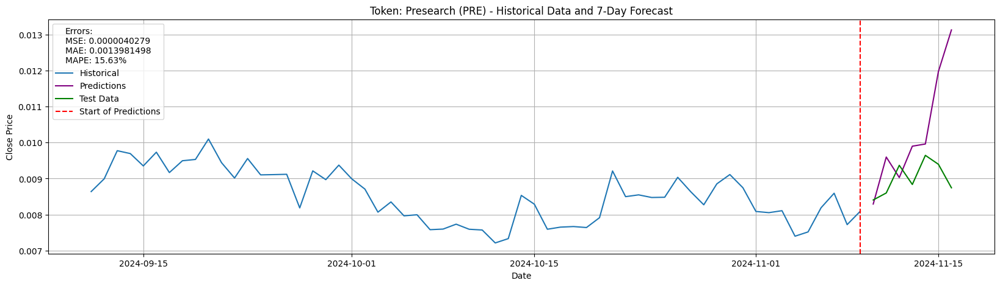

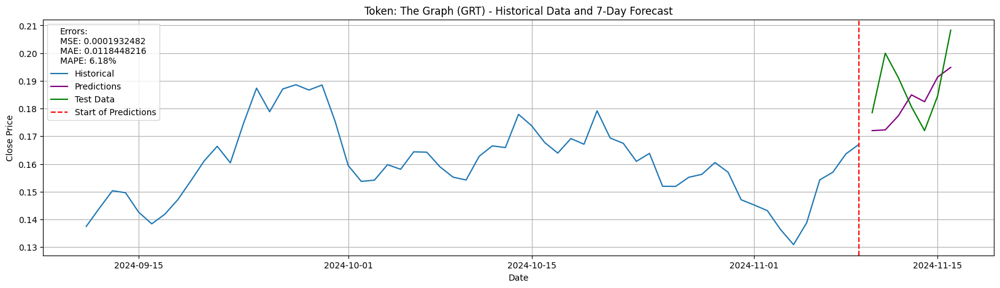

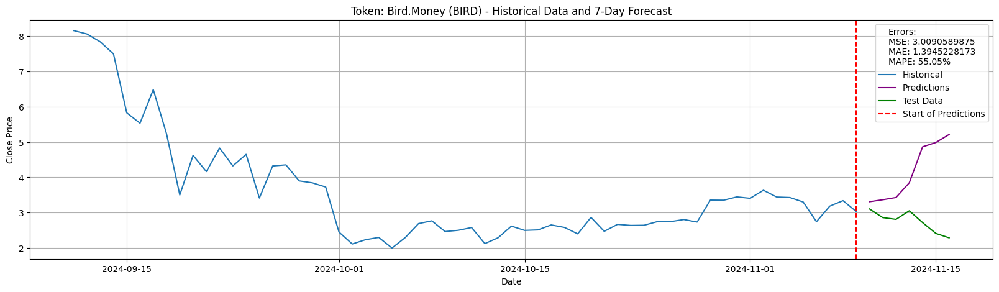

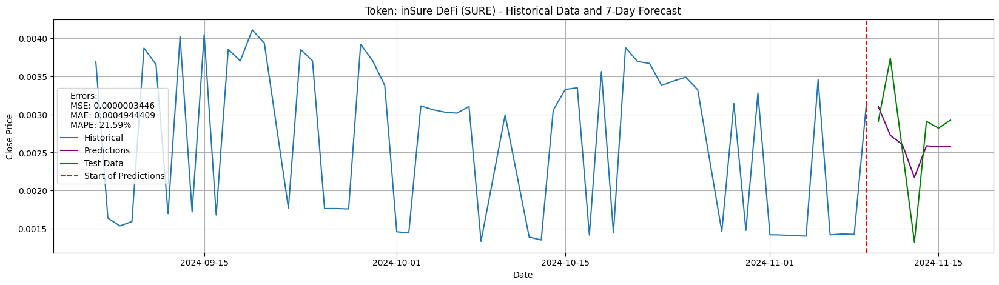

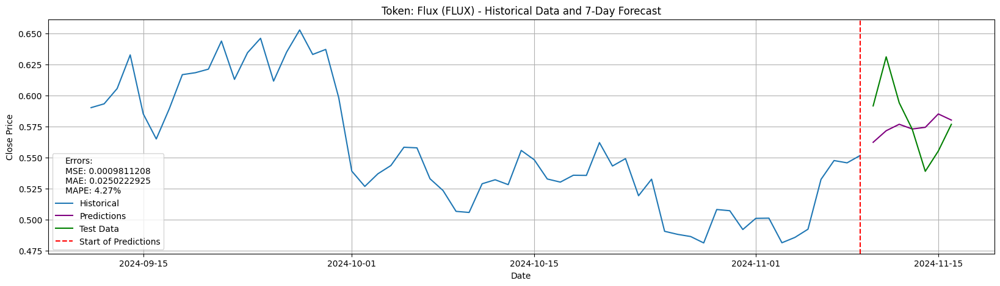

In [25]:
u.plot_predictions(train_data=ai_obj.og_train, predictions_x_days=ai_obj.og_pred, test_data=ai_test, last_data_points=60)

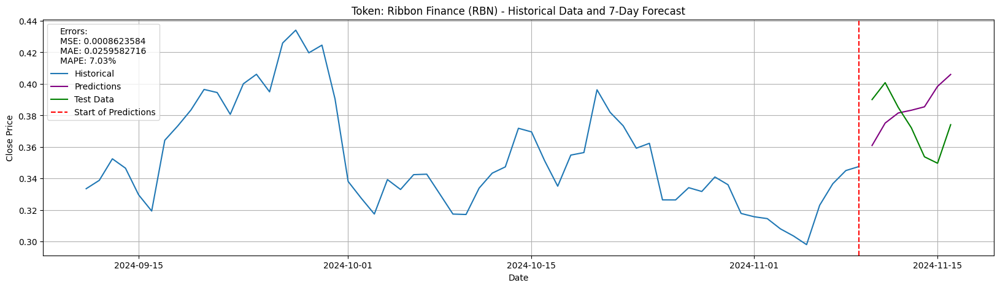

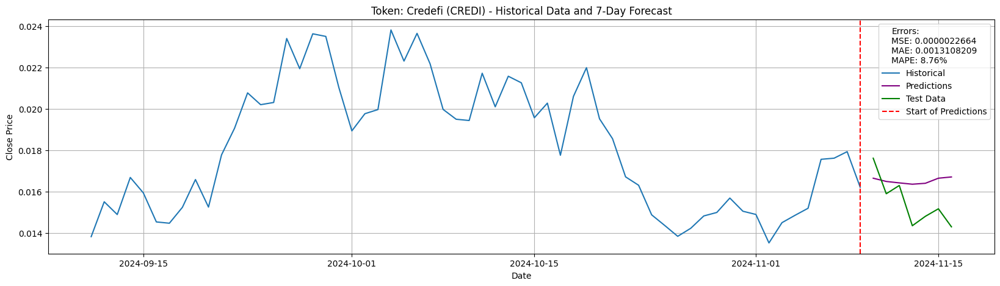

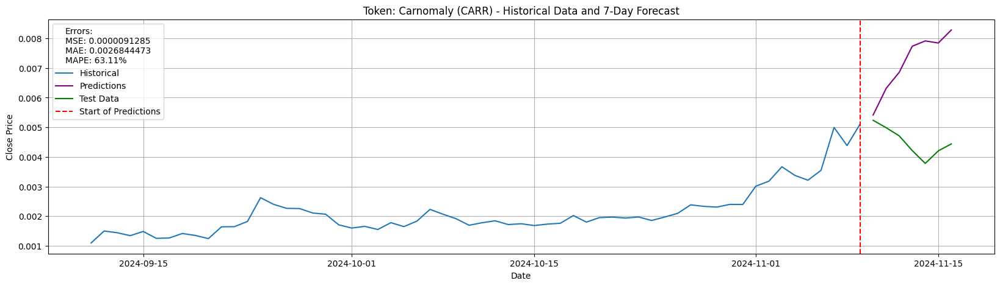

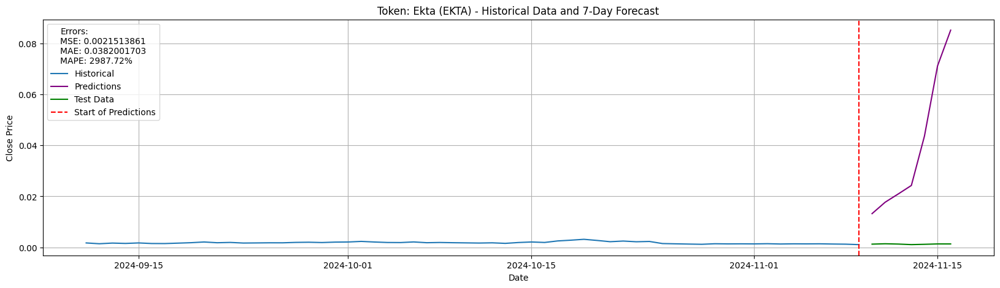

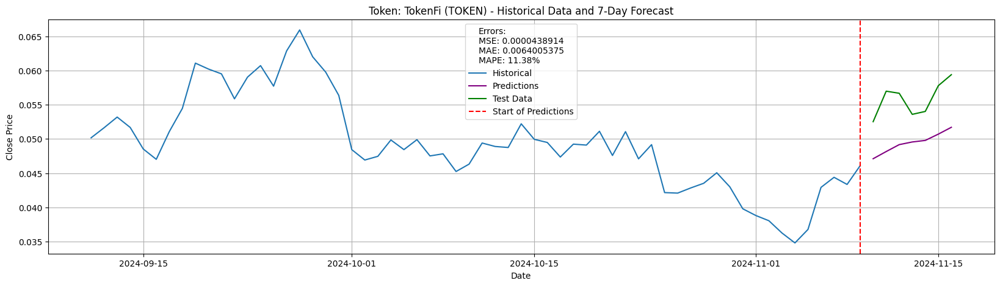

...

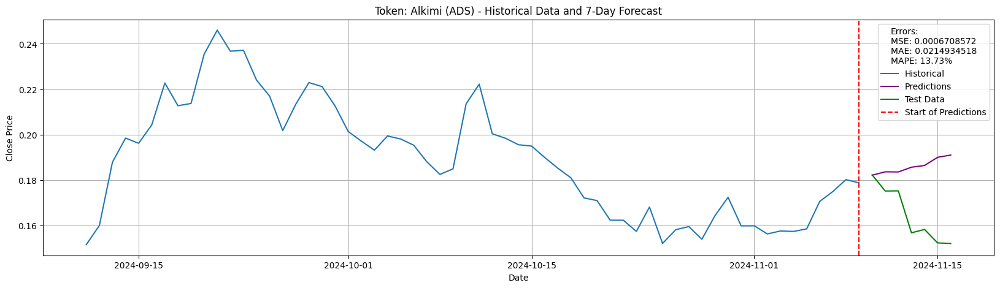

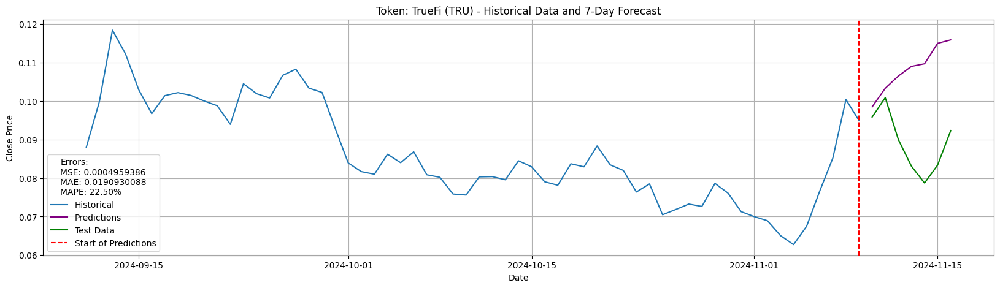

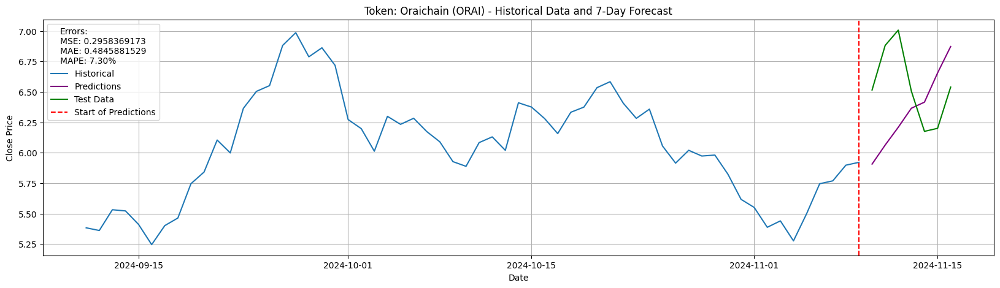

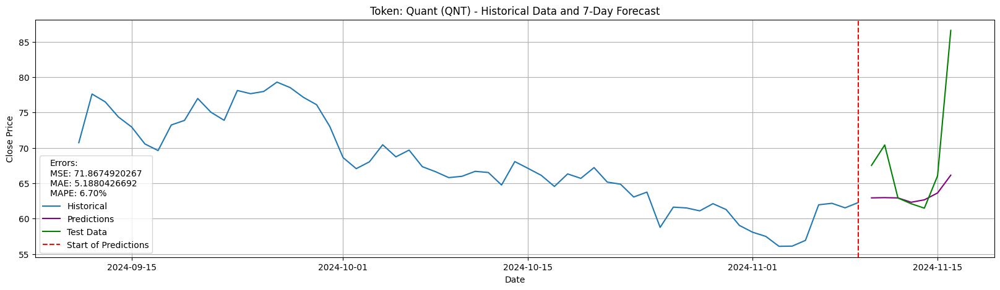

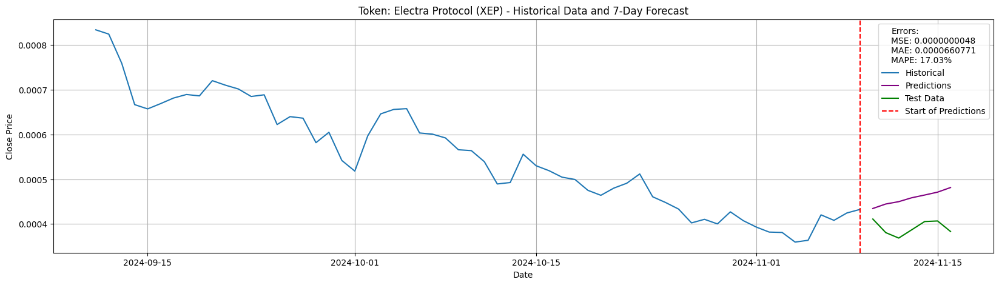

In [26]:
u.plot_predictions(train_data=rwa_obj.og_train, predictions_x_days=rwa_obj.og_pred, test_data=rwa_test, last_data_points=60)